## Examing Listing Price Indicator in Tourism Industry - Case Study from Airbnb -

This code provides a narative analytical process for price prediction data from Airbnb

### Analytical Question

The aim of this project is to create the model along with analytical question. 
Analytical Question is Listed below:

### i.	How does geographical location affect the price and how much does it contribute to the model?

### ii.	How does room quality affect the price and how much does it contribute to the model?

### iii. How does text information affect the listing price and how much does it contribute to the model?

### iv.	What is the ideal predictive model for housing price?


In order to address these analytical questions, Approche has been done as follows:

### 1: Data Preparation

### 2: Data Derivation

### 3: Construction of models

### 4: Validation of results




In [88]:
 # Import libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.api as sm
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster
from sklearn.utils import shuffle
from wordcloud import WordCloud
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from matplotlib.pyplot import figure
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error
import sklearn
import re
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from geopy.distance import geodesic
import branca.colormap as cm
import warnings
from sklearn.utils import shuffle
import math
warnings.simplefilter('ignore', pd.core.common.SettingWithCopyWarning)

## Data Preparation

In [89]:
pd.set_option('display.max_columns', 100)
df = pd.read_csv('Airbnb_Listing.csv')
df.head()

,id,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,cancellation_policy,city,cleaning_fee,description,first_review,host_has_profile_pic,host_identity_verified,host_response_rate,host_since,instant_bookable,last_review,latitude,longitude,name,neighbourhood,number_of_reviews,property_type,review_scores_rating,room_type,thumbnail_url,zipcode,y
0,0,6,"{TV,""Wireless Internet"",Kitchen,""Free parking ...",2.0,Real Bed,1.0,4.0,flexible,LA,t,My place is meant for family and a few friends...,2016-07-27,t,f,NaN,2016-07-13,f,2016-07-27,33.788931,-118.154761,The Penthouse,NaN,1,Apartment,60.0,Private room,NaN,90804,138.0
1,1,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,strict,DC,t,This is a new listing for a lovely guest bedro...,2016-09-12,t,t,100%,2015-12-30,f,2017-03-31,38.934810,-76.978190,Guest Bedroom in Brookland,Brookland,9,House,100.0,Private room,https://a0.muscache.com/im/pictures/e4d8b51f-6...,20018,42.0
2,2,2,"{TV,Internet,""Wireless Internet"",Kitchen,""Indo...",2.0,Real Bed,1.0,1.0,strict,NYC,t,We're looking forward to your stay at our apt....,2016-06-15,t,f,100%,2016-05-21,t,2017-08-13,40.695118,-73.926240,Clean Modern Room in Lux Apt 1 Block From J Train,Bushwick,27,Apartment,83.0,Private room,https://a0.muscache.com/im/pictures/5ffecc9b-d...,NaN,65.0
3,3,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,strict,SF,t,BEST CITY VIEWS - - ROOF DECK W/ BBQ & WiFi - ...,2014-03-15,t,t,100%,2012-06-19,t,2017-09-03,37.796728,-122.411906,BEST views + reviews! 5/5 stars*****,Nob Hill,38,Apartment,95.0,Private room,NaN,94133,166.0
4,4,2,"{TV,Internet,""Wireless Internet"",""Air conditio...",1.0,Real Bed,1.0,1.0,strict,NYC,t,Charming Apartment on the upper west side of M...,2015-08-05,t,t,100%,2015-03-25,f,2017-09-10,40.785050,-73.974691,Charming 1-bedroom - UWS Manhattan,Upper West Side,5,Apartment,100.0,Entire home/apt,https://a0.muscache.com/im/pictures/92879730/5...,10024,165.0


In [90]:
df.shape

(55583, 29)

That means dataset has 55583 rows and 29 features

Data is already randomised so I am going to use ****75% for the training and 25% for test data.****

In [91]:
# Divide train and test data
train = df[:41689]
test = df[41870:]

Some of columns such as host information are out of scope for this reseach question. Hence, I am going to remove columns which is not related to the reserach interest.

In [92]:
train = train.rename(columns={'y':'price'})
# Remove unnecessary variables for my analytical question
train = train.drop(columns=['id','cancellation_policy','first_review','host_has_profile_pic','host_identity_verified','host_response_rate',
                     'host_since','instant_bookable','last_review','number_of_reviews','review_scores_rating','cleaning_fee'])
train.head()

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,neighbourhood,property_type,room_type,thumbnail_url,zipcode,price
0,6,"{TV,""Wireless Internet"",Kitchen,""Free parking ...",2.0,Real Bed,1.0,4.0,LA,My place is meant for family and a few friends...,33.788931,-118.154761,The Penthouse,NaN,Apartment,Private room,NaN,90804,138.0
1,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,DC,This is a new listing for a lovely guest bedro...,38.934810,-76.978190,Guest Bedroom in Brookland,Brookland,House,Private room,https://a0.muscache.com/im/pictures/e4d8b51f-6...,20018,42.0
2,2,"{TV,Internet,""Wireless Internet"",Kitchen,""Indo...",2.0,Real Bed,1.0,1.0,NYC,We're looking forward to your stay at our apt....,40.695118,-73.926240,Clean Modern Room in Lux Apt 1 Block From J Train,Bushwick,Apartment,Private room,https://a0.muscache.com/im/pictures/5ffecc9b-d...,NaN,65.0
3,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,SF,BEST CITY VIEWS - - ROOF DECK W/ BBQ & WiFi - ...,37.796728,-122.411906,BEST views + reviews! 5/5 stars*****,Nob Hill,Apartment,Private room,NaN,94133,166.0
4,2,"{TV,Internet,""Wireless Internet"",""Air conditio...",1.0,Real Bed,1.0,1.0,NYC,Charming Apartment on the upper west side of M...,40.785050,-73.974691,Charming 1-bedroom - UWS Manhattan,Upper West Side,Apartment,Entire home/apt,https://a0.muscache.com/im/pictures/92879730/5...,10024,165.0


/opt/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:xlabel='price', ylabel='Density'>

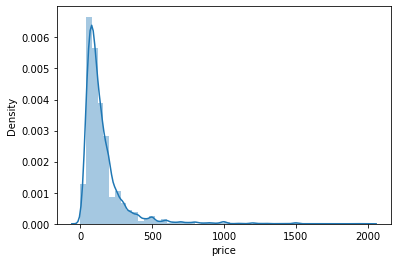

In [93]:
# Visualise the plot for the target variable, price
sns.distplot(train['price'])

Price data seems to have many outliers. In order to remove them, I am going to use IQR measure to detect outlier in statistical manner


Code for IQR measure is refered by this website https://medium.com/@prashant.nair2050/hands-on-outlier-detection-and-treatment-in-python-using-1-5-iqr-rule-f9ff1961a414

In [94]:
# Remove outliers based upon IQR measure
def outlier(df):
    Q1,Q3 = np.percentile(df, [25,75])
    IQR = Q3 - Q1
    lower_threshold = Q1 - (1.5 * IQR)
    upper_threshold = Q3 + (1.5 * IQR)
    return lower_threshold,upper_threshold

lowerbound,upperbound = outlier(train['price'])

train = train.drop(train[(train['price'] > upperbound) | (train['price']  < lowerbound) ].index)

/opt/anaconda3/lib/python3.7/site-packages/seaborn/distributions.py:2551: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



Text(0.5, 1.0, 'Price after outlier removal')

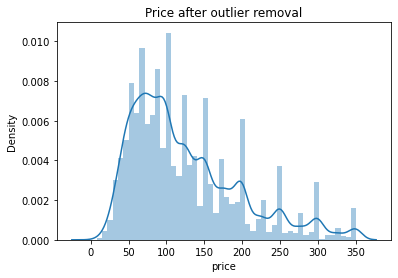

In [95]:
ax = sns.distplot(train['price'])
ax.set_title('Price after outlier removal')

In [96]:
# Check the null value
train.isnull().sum()

accommodates        0
amenities           0
bathrooms         103
bed_type            0
bedrooms           50
beds               69
city                0
description         0
latitude            0
longitude           0
name                0
neighbourhood    3580
property_type       0
room_type           0
thumbnail_url    3980
zipcode           470
price               0
dtype: int64

I could see there are some numerical valuable so I am trying to impute the missing value as a part of data preparation.

### Null values for Bathroom, Bedrooms, Bed

In [97]:
null_room = df[df['bathrooms'].isnull() | df['bedrooms'].isnull() | df['beds'].isnull()]
null_room.head(10)

,id,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,cancellation_policy,city,cleaning_fee,description,first_review,host_has_profile_pic,host_identity_verified,host_response_rate,host_since,instant_bookable,last_review,latitude,longitude,name,neighbourhood,number_of_reviews,property_type,review_scores_rating,room_type,thumbnail_url,zipcode,y
89,89,1,"{Internet,""Wireless Internet"",""Air conditionin...",NaN,Real Bed,1.0,1.0,flexible,Chicago,t,"This room is all about comfort, convenience an...",2012-09-05,t,t,100%,2011-08-22,f,2017-01-11,41.830304,-87.619954,Cozy Upstairs Single - Soji,Bronzeville,74,House,86.0,Private room,https://a0.muscache.com/im/pictures/1421b264-5...,60653,29.0
92,92,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,NaN,2.0,strict,NYC,t,"Sorry, this listing is no longer available.",2010-09-14,t,t,NaN,2010-05-07,f,2011-12-10,40.722449,-73.985270,East Village Sanctuary,Alphabet City,25,Apartment,96.0,Entire home/apt,NaN,10009.0,100.0
161,161,2,"{Internet,""Wireless Internet"",""Air conditionin...",NaN,Real Bed,1.0,1.0,strict,NYC,t,1 bedroom in a 2 bedrooms apartment (Midtown W...,2010-08-31,t,t,87%,2010-07-17,f,2017-08-31,40.762330,-73.988541,1 br in a 2 br apt (Midtown West),Hell's Kitchen,29,Apartment,96.0,Private room,https://a0.muscache.com/im/pictures/fd1bffd9-c...,10019,119.0
175,175,2,"{""Wireless Internet"",""Air conditioning"",Heatin...",1.0,Real Bed,1.0,NaN,strict,NYC,t,Newly furbished cozy room in Elmhurst (Jackson...,2016-03-21,t,t,94%,2014-07-04,t,2017-09-25,40.746019,-73.873344,Easily accessible cozy room!,Elmhurst,59,House,98.0,Private room,https://a0.muscache.com/im/pictures/c78a1b49-c...,11373.0,55.0
342,342,3,"{TV,""Wireless Internet"",""Air conditioning"",Kit...",1.0,Real Bed,1.0,NaN,flexible,DC,t,"Located in the heart of the city, you are walk...",NaN,t,f,NaN,2015-05-02,f,NaN,38.915614,-77.038808,"Corner studio, close to everything",U Street Corridor,0,Apartment,NaN,Entire home/apt,NaN,20009,800.0
395,395,4,"{""Cable TV"",""Wireless Internet"",""Air condition...",1.0,Real Bed,NaN,2.0,strict,NYC,f,This Duplex Loft Suite with a Terrace offers a...,2011-11-20,t,t,100%,2011-03-01,t,2016-03-27,40.737757,-73.953271,Duplex w/ Terrace @ Box House Hotel,Greenpoint,8,Apartment,100.0,Entire home/apt,https://a0.muscache.com/im/pictures/21910837/b...,11222,349.0
532,532,1,"{""Wireless Internet"",Kitchen,Breakfast,Heating...",NaN,Airbed,1.0,1.0,strict,SF,t,This room is in our prayer room & discussion p...,2012-04-25,t,t,100%,2011-07-12,t,2017-09-26,37.726064,-122.432316,Sleep in AUM Versity alter room.,Excelsior,21,House,98.0,Private room,https://a0.muscache.com/im/pictures/3501991/0c...,94112,60.0
1899,1899,2,"{Internet,""Wireless Internet"",""Air conditionin...",1.0,Real Bed,1.0,NaN,moderate,NYC,t,"Bright room, minimalist design in a newly buil...",2015-09-04,t,t,NaN,2014-12-18,f,2015-10-19,40.712481,-73.963792,Sunny Room in Williamsburg Brooklyn,Williamsburg,5,Apartment,80.0,Private room,https://a0.muscache.com/im/pictures/108418337/...,11249.0,90.0
1908,1908,2,"{""Wireless Internet"",""Air conditioning"",""Wheel...",1.0,Real Bed,1.0,NaN,flexible,NYC,t,"Recently moved in, travel tons, so I rent to p...",NaN,t,f,NaN,2016-01-15,t,NaN,40.634587,-74.028780,Big and cozy,Bay Ridge,0,Apartment,NaN,Private room,https://a0.muscache.com/im/pictures/6ea336ec-a...,11209,100.0
1963,1963,4,"{TV,""Cable TV"",""Wireless Internet"",""Air condit...",1.0,Real Bed,NaN,2.0,strict,NYC,f,Charming studio loft @ The Box House Hotel. Lo...,2011-11-20,t,t,100%,2011-03-01,f,2015-11-03,40.737834,-73.952587,Loft w/ Terrace @ Box House Hotel,Greenpoint,3,Apartment,100.0,Entire home/apt,NaN,11222,249.0


As you can see from the dataset, we can estimate the number of beds, bedroom and bathrooms by the number of accomodates.

In this case,the assumption for imputing null values is as follows:

<br>***the number of the bathroom should be one for each property.***

<br>・***The number of beds*** should be calucurated as follows
<br> (1) ***1 or 2 accomodates should be 1 beds***
<br> (2) ***3 or 4 accomodates should be 2 beds***
<br> (3) ***Anything beyond 4 should be 3 beds***


<br>・***The number of bedrooms*** should be calucurated as follows
<br> (1) ***1-4 accomodates should be 1 bedrooms***
<br> (2) ***More than 4 accomodates should be 2 bedrooms***

<br> Based upon this assumption, I am going to impute null values

In [98]:
train['bathrooms'] = train["bathrooms"].fillna(1)
train['beds'] = train['beds'].fillna(train['accommodates'].apply(lambda x: 1 if x==1 or 2 else (2 if x==3 or 4 else 3)))
train['bedrooms'] = train['bedrooms'].fillna(train['accommodates'].apply(lambda x: 2 if x>4 else 1))

### Null value for Neighbourhood and Zipcode

#### Neighbourhood 

In [99]:
null_location = train[train['neighbourhood'].isnull() | train['zipcode'].isnull()]
null_location.head(10)

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,neighbourhood,property_type,room_type,thumbnail_url,zipcode,price
0,6,"{TV,""Wireless Internet"",Kitchen,""Free parking ...",2.0,Real Bed,1.0,4.0,LA,My place is meant for family and a few friends...,33.788931,-118.154761,The Penthouse,NaN,Apartment,Private room,NaN,90804,138.0
2,2,"{TV,Internet,""Wireless Internet"",Kitchen,""Indo...",2.0,Real Bed,1.0,1.0,NYC,We're looking forward to your stay at our apt....,40.695118,-73.926240,Clean Modern Room in Lux Apt 1 Block From J Train,Bushwick,Apartment,Private room,https://a0.muscache.com/im/pictures/5ffecc9b-d...,NaN,65.0
14,8,"{""Pets allowed"",""Family/kid friendly""}",1.0,Real Bed,2.0,4.0,Chicago,Beautifully remodeled building in Logan Square...,41.916837,-87.720021,Classic Logan Square three bedroom,NaN,Apartment,Entire home/apt,https://a0.muscache.com/im/pictures/ab3da7ab-9...,60647,350.0
19,2,"{Pool,""Free parking on premises"",Heating,""Fami...",1.0,Real Bed,1.0,1.0,LA,Our cozy and comfortable fully remodeled priva...,34.154915,-118.030139,Cozy Private Bdrm w/ Own Entrance,NaN,House,Private room,https://a0.muscache.com/im/pictures/24cc5fa8-c...,91006,69.0
37,2,"{""Wireless Internet"",""Air conditioning"",Kitche...",1.0,Real Bed,2.0,1.0,DC,Private bedroom with a queen-sized bed (2 peop...,38.899897,-77.019182,1 bedroom Downtown DC!,NaN,Apartment,Private room,https://a0.muscache.com/im/pictures/d6d7c015-8...,20001,200.0
44,1,"{""Wireless Internet"",Kitchen,""Free parking on ...",1.0,Real Bed,1.0,1.0,LA,"My place is close to Hermosa Pier, LAX airport...",33.872050,-118.366895,"Quite, Clean and Affordable with queen bed",NaN,Apartment,Entire home/apt,https://a0.muscache.com/im/pictures/efe1da28-d...,90278,95.0
71,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,LA,"550sqFtAttached Guest House,Two connecting Roo...",34.185751,-118.652343,Neat Guest House With Private Entrance,NaN,House,Entire home/apt,https://a0.muscache.com/im/pictures/38dcefdf-1...,91307,65.0
72,2,"{Internet,Kitchen,""Pets allowed"",Breakfast,""Pe...",1.0,Real Bed,1.0,1.0,LA,"Cute, shabby chic Hollywood Bungalow just step...",34.095553,-118.347174,Cozy Original Hollywood Bungalow,NaN,House,Entire home/apt,https://a0.muscache.com/im/pictures/f697d176-5...,90046,90.0
76,2,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",2.0,Real Bed,1.0,1.0,LA,Best. Place. Ever!!!! FREE BIKES! FREE BREAKFA...,33.990602,-118.455510,Spacious Oasis at Venice Beach!!~1,NaN,House,Private room,https://a0.muscache.com/im/pictures/9d0ba7d5-d...,90291,109.0
88,2,"{""translation missing: en.hosting_amenity_49"",...",1.0,Real Bed,1.0,2.0,LA,"quiet,convince,safety",34.011442,-117.872207,Walnut sweet room as home,NaN,House,Private room,https://a0.muscache.com/im/pictures/43d5a9f3-0...,91789,35.0


In [100]:
# Show the null value for the dataset
null_location.isnull().sum()

accommodates        0
amenities           0
bathrooms           0
bed_type            0
bedrooms            0
beds                0
city                0
description         0
latitude            0
longitude           0
name                0
neighbourhood    3580
property_type       0
room_type           0
thumbnail_url     481
zipcode           470
price               0
dtype: int64

In [101]:
# Show the neighbourhood where there are only one unique neighbourhood in the dataset
train['neighbourhood'].value_counts().tail(50)

South Gate                  1
Garfield Ridge              1
Watertown                   1
Huguenot                    1
Washington Park             1
Dunning                     1
Rossville                   1
Grand Crossing              1
West Town                   1
Hillbrook                   1
Pullman                     1
Fresh Meadows               1
New Dorp Beach              1
Barry Farm                  1
West Lawn                   1
Bellevue                    1
Castleton Corners           1
Florence-Graham             1
Magnificent Mile            1
Chillum, MD                 1
Sea Cliff                   1
Gateway                     1
Mt. Vernon Square           1
Bethesda, MD                1
Grant City                  1
Ashburn                     1
Mission Hills               1
Printers Row                1
North Park                  1
Clearing                    1
Government Center           1
Rolling Hills               1
Brookline                   1
Fort Totte

Since there are so many neighbourhood where there are only one accomodation for the dataset, it could not be useful to use this features on our model. Hence. I am going not to impute the null value and this variable will be removed from future analysis. 

In [102]:
train = train.drop(columns='neighbourhood')
train.isnull().sum()

accommodates        0
amenities           0
bathrooms           0
bed_type            0
bedrooms            0
beds                0
city                0
description         0
latitude            0
longitude           0
name                0
property_type       0
room_type           0
thumbnail_url    3980
zipcode           470
price               0
dtype: int64

#### Zipcode

In [103]:
zip_null = df[df['zipcode'].isnull()]
zip_null

,id,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,cancellation_policy,city,cleaning_fee,description,first_review,host_has_profile_pic,host_identity_verified,host_response_rate,host_since,instant_bookable,last_review,latitude,longitude,name,neighbourhood,number_of_reviews,property_type,review_scores_rating,room_type,thumbnail_url,zipcode,y
2,2,2,"{TV,Internet,""Wireless Internet"",Kitchen,""Indo...",2.0,Real Bed,1.0,1.0,strict,NYC,t,We're looking forward to your stay at our apt....,2016-06-15,t,f,100%,2016-05-21,t,2017-08-13,40.695118,-73.926240,Clean Modern Room in Lux Apt 1 Block From J Train,Bushwick,27,Apartment,83.0,Private room,https://a0.muscache.com/im/pictures/5ffecc9b-d...,NaN,65.0
110,110,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,flexible,DC,t,The room has a newly finished floor and fresh ...,2015-02-27,t,t,100%,2013-11-14,f,2017-01-23,38.928715,-77.022289,Private Rm in Pleasant Plns Twnhse,NaN,33,House,85.0,Private room,https://a0.muscache.com/im/pictures/61803984/3...,NaN,68.0
133,133,6,"{TV,""Wireless Internet"",""Air conditioning"",Poo...",2.0,Real Bed,2.0,3.0,flexible,LA,f,"2 bdrm 2 bath, steam shower, 3 flat screen TV'...",NaN,t,f,100%,2017-02-11,t,NaN,34.099994,-118.796960,Guest House Santa Monica Mountains,NaN,0,Guesthouse,NaN,Entire home/apt,https://a0.muscache.com/im/pictures/6cbf507d-4...,NaN,1500.0
163,163,2,"{Internet,""Wireless Internet"",""Air conditionin...",1.0,Real Bed,1.0,1.0,flexible,LA,t,TEagle Rock is an un-pretentious neighborhood ...,2016-07-24,t,t,70%,2014-06-02,f,2017-04-02,34.128203,-118.217615,Chilled Out NELA Pad,NaN,4,Apartment,95.0,Entire home/apt,NaN,NaN,90.0
445,445,1,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,strict,LA,f,I love my WeHo apartment. It's like a private ...,2015-12-09,t,f,100%,2014-12-09,f,2016-02-02,34.089742,-118.386142,West Hollywood comfort,West Hollywood,2,Apartment,100.0,Private room,https://a0.muscache.com/im/pictures/78780190/c...,NaN,94.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55028,55028,2,"{TV,Internet,""Wireless Internet"",""Air conditio...",2.0,Real Bed,1.0,1.0,moderate,NYC,t,"Hello All, My Name is Denise Thirkill, I am fr...",2014-04-07,t,t,100%,2014-03-29,f,2017-08-27,40.841918,-73.911079,"Priv. Room in a House,15min,Manhatt",Claremont,35,House,93.0,Private room,https://a0.muscache.com/im/pictures/45095621/f...,NaN,44.0
55162,55162,2,"{TV,Internet,""Wireless Internet"",""Air conditio...",1.0,Real Bed,0.0,1.0,strict,NYC,t,Blocks away from the Bedford L train in the he...,2015-12-26,t,f,70%,2015-11-15,f,2017-09-11,40.720690,-73.954533,Luxury Studio Heart of Williamsburg,Williamsburg,99,Apartment,97.0,Entire home/apt,https://a0.muscache.com/im/pictures/174bb7f4-5...,NaN,189.0
55436,55436,2,"{""Wireless Internet"",Kitchen,""Free parking on ...",1.0,Futon,0.0,1.0,strict,Chicago,t,"My studio is my sacred space. Red, black, and ...",2016-03-20,t,t,100%,2015-06-21,f,2016-06-14,41.969203,-87.693121,"Cozy, Trains, and Community",NaN,2,Apartment,100.0,Entire home/apt,https://a0.muscache.com/im/pictures/8f472fea-8...,NaN,52.0
55525,55525,3,"{TV,""Wireless Internet"",""Air conditioning"",Poo...",1.0,Real Bed,1.0,1.0,moderate,LA,t,"My place is close to calabasas,woodland hills,...",NaN,t,t,100%,2016-01-23,f,NaN,34.184656,-118.653283,NICE AND RELAXING GuestHouse With Private Entr...,NaN,0,House,NaN,Private room,https://a0.muscache.com/im/pictures/1c0bf1d4-e...,NaN,62.0


In [104]:
train.dropna(subset=['zipcode'],inplace=True)
train.isnull().sum()

accommodates        0
amenities           0
bathrooms           0
bed_type            0
bedrooms            0
beds                0
city                0
description         0
latitude            0
longitude           0
name                0
property_type       0
room_type           0
thumbnail_url    3934
zipcode             0
price               0
dtype: int64

#### Thumbnail_url

No thmbnail means there is no photo when they post the accommodation in the listing price. I assume that having a image could be a indicator to affect the listing price. Hence, I am trying to create the new feature based upon whether or not they have a Thumbnail_url. This technique also touches on Data derivation. 

In [105]:
# Feature-engineering for thumbnail_url
train['thumbnail_url'] = train['thumbnail_url'].isnull() * 1
train.head()

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,property_type,room_type,thumbnail_url,zipcode,price
0,6,"{TV,""Wireless Internet"",Kitchen,""Free parking ...",2.0,Real Bed,1.0,4.0,LA,My place is meant for family and a few friends...,33.788931,-118.154761,The Penthouse,Apartment,Private room,1,90804,138.0
1,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,DC,This is a new listing for a lovely guest bedro...,38.934810,-76.978190,Guest Bedroom in Brookland,House,Private room,0,20018,42.0
3,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,SF,BEST CITY VIEWS - - ROOF DECK W/ BBQ & WiFi - ...,37.796728,-122.411906,BEST views + reviews! 5/5 stars*****,Apartment,Private room,1,94133,166.0
4,2,"{TV,Internet,""Wireless Internet"",""Air conditio...",1.0,Real Bed,1.0,1.0,NYC,Charming Apartment on the upper west side of M...,40.785050,-73.974691,Charming 1-bedroom - UWS Manhattan,Apartment,Entire home/apt,0,10024,165.0
5,2,"{""Wireless Internet"",""Air conditioning"",Kitche...",1.0,Real Bed,1.0,1.0,NYC,I have other listings in the same apartment: h...,40.640241,-74.015729,"Close NYU Langone H, Room A/3min to Subway",House,Private room,0,11220,55.0


## Data Derivation

### How does geographical location affect the price and How much does it contribute to the model?

##### Latitude/Longitude vs Price

This code is refered by https://stackoverflow.com/questions/39401729/plot-latitude-longitude-points-from-dataframe-on-folium-map-ipython

In [106]:
# Define the circleamaker by using folium
def plotDot(point):    
    folium.CircleMarker(location=[point.latitude, point.longitude],
                        radius=0.01,
                        weight=5,opacity=0.6,fill=False).add_to(this_map)

In [107]:
#create a map
this_map = folium.Map(prefer_canvas=True)
LA = train[train['city']=='LA']
LA.apply(plotDot, axis = 1)

#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())
this_map

In [108]:
#create a map
this_map = folium.Map(prefer_canvas=True)
DC = train[train['city']=='DC']
DC.apply(plotDot, axis = 1)

#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

this_map

In [109]:
#create a map
this_map = folium.Map(prefer_canvas=True)
SF = train[train['city']=='SF']
SF.apply(plotDot, axis = 1)

#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

this_map

In [110]:
#create a map
this_map = folium.Map(prefer_canvas=True)
NYC = train[train['city']=='NYC']
NYC.apply(plotDot, axis = 1)

#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

this_map

In [111]:
#create a map
this_map = folium.Map(prefer_canvas=True)
Chicago = train[train['city']=='Chicago']
Chicago.apply(plotDot, axis = 1)

#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

this_map

In [112]:
#create a map
this_map = folium.Map(prefer_canvas=True)
Boston = train[train['city']=='Boston']
Boston.apply(plotDot, axis = 1)

#Set the zoom to the maximum possible
this_map.fit_bounds(this_map.get_bounds())

this_map

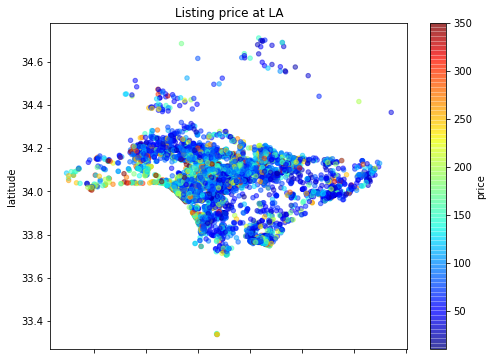

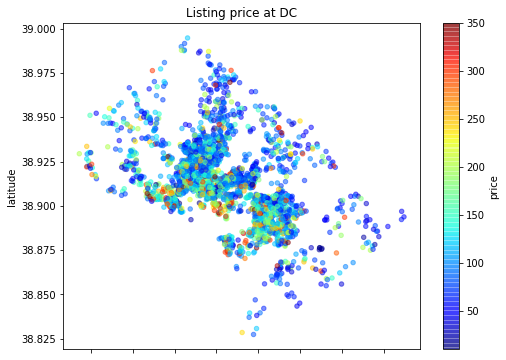

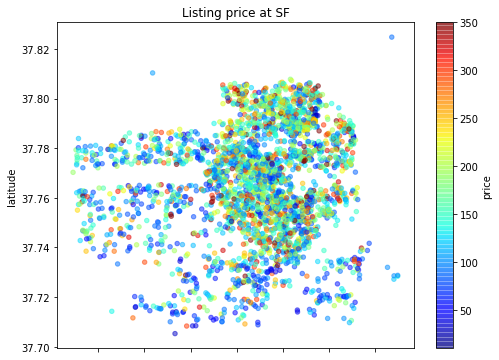

In [113]:
# Visualise the listing accommodation for LA,DC,SF with each price
city = ['LA','DC','SF']
for i in city:
    ax = train[train['city'] == i].plot(kind="scatter", x="longitude", y="latitude",
            c="price", cmap=plt.get_cmap("jet"),
            colorbar=True, alpha=0.5, figsize=(8,6))
    plt.title('Listing price at {}'.format(i))
    plt.show()

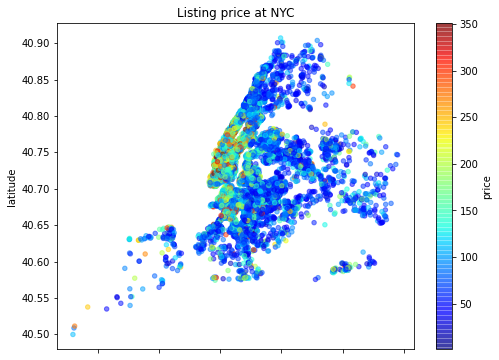

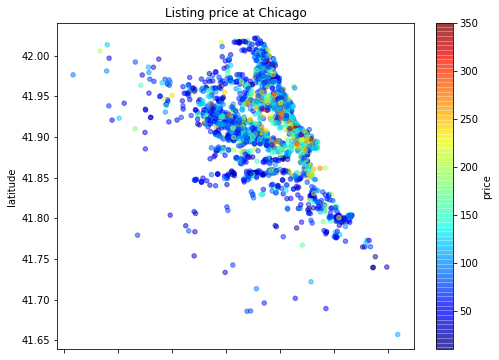

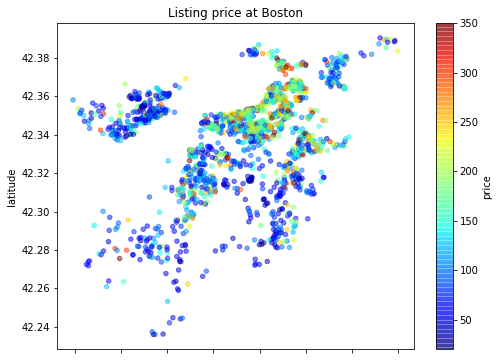

In [114]:
# Visualise the listing accommodation for NYC, Chicago, Boston with each price
city_2 = ['NYC','Chicago','Boston']
for i in city_2:
    ax = train[train['city'] == i].plot(kind="scatter", x="longitude", y="latitude",
            c="price", cmap=plt.get_cmap("jet"),
            colorbar=True, alpha=0.5, figsize=(8,6))
    plt.title('Listing price at {}'.format(i))
    plt.show()

As you can see, in some regions such as NYC, Boston, LA, high price accommodation is highly gathered around one specific area. Hence, by utilising thease information, I am going to create some of the features based upon this.

For isntance, from these two maps, in LA, around Santa Monica seems to be high price region. So I am going to calucurate ****the distance between Santa Monica's most iconic place, 'Santa Monica Piar' and each accommodations.****

In [115]:
# Specify the iconic place in each area and calucurate the distance from each accommodation
Santa_Monica_Pier = (34.010090, -118.496948)
LA["distance_from_central"] = LA.apply(lambda x:geodesic((x["latitude"], x["longitude"]), Santa_Monica_Pier), axis=1)

White_House = (38.897957,-77.036560)
DC['distance_from_central'] = DC.apply(lambda x:geodesic((x["latitude"], x["longitude"]), White_House), axis=1)

Misson_Dolores_Park = (37.759773,-122.427063)
SF['distance_from_central'] = SF.apply(lambda x:geodesic((x["latitude"], x["longitude"]), Misson_Dolores_Park), axis=1)

SOHO = (40.758896,-73.985130)
NYC['distance_from_central'] = NYC.apply(lambda x:geodesic((x["latitude"], x["longitude"]), SOHO), axis=1)

Willis_Tower = (41.878876, -87.635918)
Chicago['distance_from_central'] = Chicago.apply(lambda x:geodesic((x["latitude"], x["longitude"]), Willis_Tower), axis=1)

State_House = (42.3587085, -71.0636623) 
Boston['distance_from_central'] = Boston.apply(lambda x:geodesic((x["latitude"], x["longitude"]), State_House), axis=1)

In [116]:
# Using inner merge and pandas concat to use 
LA_train = pd.merge(train, LA, how="inner")
DC_train = pd.merge(train, DC, how="inner")
SF_train = pd.merge(train, SF, how="inner")
NYC_train = pd.merge(train, NYC, how="inner")
Chicago_train = pd.merge(train, Chicago, how="inner")
Boston_train = pd.merge(train, Boston, how="inner")

In [117]:
LA_train.head()

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central
0,6,"{TV,""Wireless Internet"",Kitchen,""Free parking ...",2.0,Real Bed,1.0,4.0,LA,My place is meant for family and a few friends...,33.788931,-118.154761,The Penthouse,Apartment,Private room,1,90804,138.0,40.043679092335125 km
1,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Pull-out Sofa,1.0,1.0,LA,- Located in beautiful Park LaBrea Apartments ...,34.068441,-118.353515,1 BR Available In Park La Brea Apts,Apartment,Private room,1,90036,150.0,14.74180919810263 km
2,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,LA,* Check sister listing if booked https://www.a...,34.088550,-118.268238,Modern Silver Lake Gem,House,Entire home/apt,0,90026,145.0,22.84018950238017 km
3,2,"{""Wireless Internet"",""Air conditioning"",Kitche...",1.0,Real Bed,1.0,1.0,LA,"My place is close to In-N-Out Burger, Hollywoo...",34.097690,-118.350587,WEST HOLLYWOOD ROOM BY RUNYON CANYON,Apartment,Private room,0,90046,100.0,16.643890081640265 km
4,2,"{Pool,""Free parking on premises"",Heating,""Fami...",1.0,Real Bed,1.0,1.0,LA,Our cozy and comfortable fully remodeled priva...,34.154915,-118.030139,Cozy Private Bdrm w/ Own Entrance,House,Private room,0,91006,69.0,45.98171129317117 km


In [118]:
# Combine all of the datas to add distance from central 
train = pd.concat([LA_train,DC_train,SF_train,NYC_train,Chicago_train,Boston_train],axis=0)
train.shape

(38368, 17)

In [119]:
#Change distance to float since
train['distance_from_central'] = train['distance_from_central'].astype(str)
train['distance_from_central'] = train['distance_from_central'].str.split(' ', expand=True)[0]
train['distance_from_central'] = train['distance_from_central'].astype(float)

#### City vs Price 

In [120]:
train.head()

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central
0,6,"{TV,""Wireless Internet"",Kitchen,""Free parking ...",2.0,Real Bed,1.0,4.0,LA,My place is meant for family and a few friends...,33.788931,-118.154761,The Penthouse,Apartment,Private room,1,90804,138.0,40.043679
1,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Pull-out Sofa,1.0,1.0,LA,- Located in beautiful Park LaBrea Apartments ...,34.068441,-118.353515,1 BR Available In Park La Brea Apts,Apartment,Private room,1,90036,150.0,14.741809
2,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,LA,* Check sister listing if booked https://www.a...,34.088550,-118.268238,Modern Silver Lake Gem,House,Entire home/apt,0,90026,145.0,22.840190
3,2,"{""Wireless Internet"",""Air conditioning"",Kitche...",1.0,Real Bed,1.0,1.0,LA,"My place is close to In-N-Out Burger, Hollywoo...",34.097690,-118.350587,WEST HOLLYWOOD ROOM BY RUNYON CANYON,Apartment,Private room,0,90046,100.0,16.643890
4,2,"{Pool,""Free parking on premises"",Heating,""Fami...",1.0,Real Bed,1.0,1.0,LA,Our cozy and comfortable fully remodeled priva...,34.154915,-118.030139,Cozy Private Bdrm w/ Own Entrance,House,Private room,0,91006,69.0,45.981711


<AxesSubplot:xlabel='city', ylabel='price'>

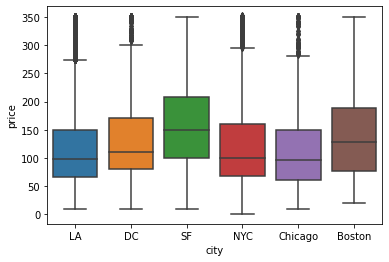

In [121]:
# Visualise boxplot
sns.boxplot(x='city',y='price',data=train)

It seems that city might be an important factor for the listing price. For instance, the price in SF seems to be higher than other cities. Hence, I am going to change to encode this variable.

In [122]:
# Label encoding for city
train['city'] = train['city'].apply(lambda x:0 if x=='LA' 
                                    else(1 if x=='DC' else(2 if x=='SF' else(3 if x=='NYC' else(4 if x=='Chicago' else(5))))))

In [123]:
train.head()

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central
0,6,"{TV,""Wireless Internet"",Kitchen,""Free parking ...",2.0,Real Bed,1.0,4.0,0,My place is meant for family and a few friends...,33.788931,-118.154761,The Penthouse,Apartment,Private room,1,90804,138.0,40.043679
1,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Pull-out Sofa,1.0,1.0,0,- Located in beautiful Park LaBrea Apartments ...,34.068441,-118.353515,1 BR Available In Park La Brea Apts,Apartment,Private room,1,90036,150.0,14.741809
2,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,0,* Check sister listing if booked https://www.a...,34.088550,-118.268238,Modern Silver Lake Gem,House,Entire home/apt,0,90026,145.0,22.840190
3,2,"{""Wireless Internet"",""Air conditioning"",Kitche...",1.0,Real Bed,1.0,1.0,0,"My place is close to In-N-Out Burger, Hollywoo...",34.097690,-118.350587,WEST HOLLYWOOD ROOM BY RUNYON CANYON,Apartment,Private room,0,90046,100.0,16.643890
4,2,"{Pool,""Free parking on premises"",Heating,""Fami...",1.0,Real Bed,1.0,1.0,0,Our cozy and comfortable fully remodeled priva...,34.154915,-118.030139,Cozy Private Bdrm w/ Own Entrance,House,Private room,0,91006,69.0,45.981711


#### Zipcode vs Price

In [124]:
from IPython.display import Image
Image(url= 'https://www.smartystreets.com/img/docs/zip-code-map-large.jpg')

Zipcode could be great indicator for the accommodation location. 

The image abobe illustares how zipcode is allocated for each area. As can be seen above, ****first two digits depending on the states indicates the states and the fourth and five digits indicates more local region****. 

If I use entire zip code as a categorical variable, **there might be a case where I can not gain informative insight for the model because there are not so many same postcode**. Hence, using **the first three postcode** as a variable could be great feature engineering method as that allows to narrow down the reginal information in managable manner.

In [125]:
# Pick up the top 3 number for zipcode
train['zipcode'] = train["zipcode"].str[:3]

In [126]:
train['zipcode'].value_counts()

100    7520
112    7357
900    6105
941    3072
200    2656
606    1981
021    1698
902    1664
113     763
111     711
917     586
913     497
908     461
916     438
904     344
914     323
104     316
910     254
114     225
911     220
101     169
907     127
022     124
915     118
103     117
912     116
903      74
116      65
918      64
905      63
906      59
935      30
102      13
207       7
024       6
110       3
607       2
          2
209       2
603       2
940       2
202       1
991       1
115       1
923       1
208       1
926       1
944       1
1m        1
608       1
203       1
Nea       1
105       1
Name: zipcode, dtype: int64

Zipcode does have strange word such as Nea and 1m so this has to be removed beforehand.

In [127]:
train[train['zipcode']=='Nea']

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central
11073,4,"{TV,""Air conditioning"",Kitchen,Heating,""Family...",1.0,Real Bed,1.0,3.0,0,2010 Forest River Salem 23FBS approximately 23...,34.20785,-118.623244,MOBILE GUEST HOME IN L.A. I TAKE 2U,Camper/RV,Private room,1,Nea,89.0,24.839425


In [128]:
train[train['zipcode']=='1m']

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central
4975,3,"{""Wireless Internet"",Kitchen,Elevator,""Buzzer/...",1.0,Real Bed,1.0,2.0,3,我的A comfortable bedroom which is the same as t...,40.800009,-73.967564,Brand-New&Pretty Bedroom near Everything you w...,Apartment,Private room,0,1m,59.0,4.800369


In [129]:
train[train['zipcode']==' ']

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central
464,4,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,Real Bed,1.0,1.0,1,New spacious and bright 1-bedroom mid rise. Th...,38.936838,-76.993548,Stylish Midrise Steps from Metro,Apartment,Entire home/apt,0,,75.0,5.704847
1043,4,"{TV,Internet,""Wireless Internet"",""Air conditio...",1.0,Real Bed,1.0,1.0,1,Stylish and spacious apartment is in booming B...,38.939708,-76.994113,Stylish one bedroom+ near redline,Apartment,Private room,0,,90.0,5.918979


In [130]:
# Drop the strange zipcode
train = train.drop(index=11073, axis=0)
train = train.drop(index=4975, axis=0)
train = train.drop(index=464, axis=0)
train = train.drop(index=1043, axis=0)

In [131]:
train['zipcode'].value_counts()

100    7518
112    7357
900    6104
941    3070
200    2656
606    1979
021    1696
902    1663
113     763
111     711
917     586
913     497
908     461
916     438
904     344
914     322
104     315
910     254
114     225
911     220
101     169
907     127
022     124
915     118
103     117
912     116
903      74
116      65
918      64
905      63
906      59
935      30
102      13
207       7
024       6
110       3
940       2
209       2
603       2
607       2
115       1
991       1
202       1
208       1
923       1
926       1
944       1
608       1
203       1
105       1
Name: zipcode, dtype: int64

## How does the room quality affect the price and How much does it contribute to the model?

##### bed type 

Bed type could be a great indicator for lisiting price. Firstly, I will start with visualising a boxplot to see the general pattern of data

<AxesSubplot:xlabel='bed_type', ylabel='price'>

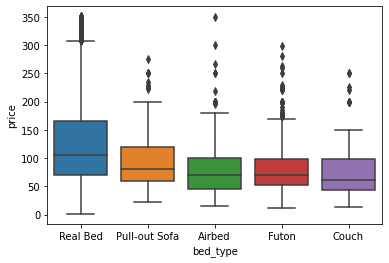

In [132]:
# Visualise the boxplot
sns.boxplot(x='bed_type',y='price',data=train)

It seems to be true that Real bed seems to represent high price compared with couch and Futon. This makes sense as Futon and Couch usually indicate cheap accommodations such as  Bed and Breakfast

This could be simply replaced by label_encoding.

In [133]:
train['bed_type'].value_counts()

Real Bed         37210
Futon              415
Pull-out Sofa      318
Airbed             260
Couch              149
Name: bed_type, dtype: int64

In [134]:
# Replace categorical variables to numerical variables
train['bed_type'] = train['bed_type'].apply(lambda x:0 if x=='Real Bed' 
                                      else(1 if x=='Pull-out Sofa' else(2 if x=='Airbed' else(3 if x=='Futon' else(4)))))

##### property_type

In [135]:
train['property_type'].value_counts()

Apartment             26132
House                  7979
Condominium            1286
Townhouse               817
Loft                    596
Guesthouse              286
Other                   278
Bed & Breakfast         251
Bungalow                198
Guest suite              74
Villa                    69
Dorm                     68
Camper/RV                53
In-law                   42
Hostel                   38
Boutique hotel           35
Cabin                    35
Timeshare                30
Boat                     28
Serviced apartment        9
Tent                      9
Yurt                      8
Vacation home             7
Hut                       5
Castle                    5
Treehouse                 4
Chalet                    3
Earth House               3
Tipi                      1
Cave                      1
Island                    1
Train                     1
Name: property_type, dtype: int64

There are so many property types so it would not be wise to encode all of the features. Hence, I am going to divide by common property types and others.

In [136]:
# Label encoding for property_type
train['property_type'] = train['property_type'].apply(lambda x:0 if x=='Apartment' 
                                                else(1 if x=='House' else(2 if x=='Condominium' 
                                                else(3 if x=='Townhouse' else(4 if x=='Loft' 
                                                else(5 if x=='Guesthouse' or x=='Bed & Breakfast' else(6)))))))

In [137]:
train['property_type'].value_counts()

0    26132
1     7979
2     1286
6     1005
3      817
4      596
5      537
Name: property_type, dtype: int64

##### room_type

Resonably speaking, room type also might be a hint to see the price in Airbnb

In [138]:
train['room_type'].value_counts()

Entire home/apt    20225
Private room       16934
Shared room         1193
Name: room_type, dtype: int64

<AxesSubplot:xlabel='room_type', ylabel='price'>

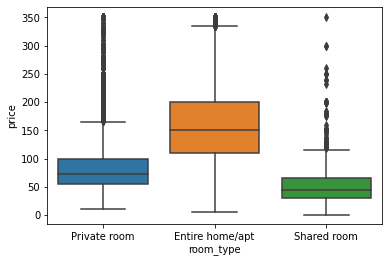

In [139]:
# Visualise the boxplot
sns.boxplot(x='room_type',y='price',data=train)

As can be seen, Entire home seems to be way more expensive than private room and shared room. 

This could be simply replaced by ***label encoding***

In [140]:
# Label encoding for room_type
train['room_type'] = train['room_type'].apply(lambda x:0 if x=='Entire home/apt' else(1 if x=='Private room' else(2)))
train.head()

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central
0,6,"{TV,""Wireless Internet"",Kitchen,""Free parking ...",2.0,0,1.0,4.0,0,My place is meant for family and a few friends...,33.788931,-118.154761,The Penthouse,0,1,1,908,138.0,40.043679
1,2,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,1,1.0,1.0,0,- Located in beautiful Park LaBrea Apartments ...,34.068441,-118.353515,1 BR Available In Park La Brea Apts,0,1,1,900,150.0,14.741809
2,3,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",1.0,0,1.0,1.0,0,* Check sister listing if booked https://www.a...,34.088550,-118.268238,Modern Silver Lake Gem,1,0,0,900,145.0,22.840190
3,2,"{""Wireless Internet"",""Air conditioning"",Kitche...",1.0,0,1.0,1.0,0,"My place is close to In-N-Out Burger, Hollywoo...",34.097690,-118.350587,WEST HOLLYWOOD ROOM BY RUNYON CANYON,0,1,0,900,100.0,16.643890
4,2,"{Pool,""Free parking on premises"",Heating,""Fami...",1.0,0,1.0,1.0,0,Our cozy and comfortable fully remodeled priva...,34.154915,-118.030139,Cozy Private Bdrm w/ Own Entrance,1,1,0,910,69.0,45.981711


## How does text data affect the listing price and how much does it contibute to the model?

#### amenities

I assume that the number of amenities might be a good indicator for the price prediction so I am going to count the number of the amenities. 

In [141]:
train['amenities'].head(10)

0    {TV,"Wireless Internet",Kitchen,"Free parking ...
1    {TV,"Cable TV",Internet,"Wireless Internet","A...
2    {TV,"Cable TV",Internet,"Wireless Internet","A...
3    {"Wireless Internet","Air conditioning",Kitche...
4    {Pool,"Free parking on premises",Heating,"Fami...
5    {TV,Internet,"Wireless Internet","Air conditio...
6    {TV,"Cable TV",Internet,"Wireless Internet","A...
7    {"Wireless Internet",Kitchen,Heating,"Smoke de...
8    {Internet,"Wireless Internet",Kitchen,"Free pa...
9    {TV,Internet,"Wireless Internet",Kitchen,"Free...
Name: amenities, dtype: object

In amenities, some amenities are using "" or {}. Hence, I am going to remove this at first and splitted by , so that we can count the number based upon each amenities.

In [142]:
# Def function for tweaking the amenities in feature-enginnering friendly manner
def change_amenities(x): 
    x = x.replace('{','')
    x = x.replace('}','')
    x = x.replace('"','')
    x = x.split(',') 
    return x 
train['amenities'] = train['amenities'].apply(change_amenities)

In [143]:
# Count the number of the amenities
train['count_amenities'] = train['amenities'].apply(lambda x: len(x))
train.head()

,accommodates,amenities,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central,count_amenities
0,6,"[TV, Wireless Internet, Kitchen, Free parking ...",2.0,0,1.0,4.0,0,My place is meant for family and a few friends...,33.788931,-118.154761,The Penthouse,0,1,1,908,138.0,40.043679,7
1,2,"[TV, Cable TV, Internet, Wireless Internet, Ai...",1.0,1,1.0,1.0,0,- Located in beautiful Park LaBrea Apartments ...,34.068441,-118.353515,1 BR Available In Park La Brea Apts,0,1,1,900,150.0,14.741809,17
2,3,"[TV, Cable TV, Internet, Wireless Internet, Ai...",1.0,0,1.0,1.0,0,* Check sister listing if booked https://www.a...,34.088550,-118.268238,Modern Silver Lake Gem,1,0,0,900,145.0,22.840190,23
3,2,"[Wireless Internet, Air conditioning, Kitchen,...",1.0,0,1.0,1.0,0,"My place is close to In-N-Out Burger, Hollywoo...",34.097690,-118.350587,WEST HOLLYWOOD ROOM BY RUNYON CANYON,0,1,0,900,100.0,16.643890,12
4,2,"[Pool, Free parking on premises, Heating, Fami...",1.0,0,1.0,1.0,0,Our cozy and comfortable fully remodeled priva...,34.154915,-118.030139,Cozy Private Bdrm w/ Own Entrance,1,1,0,910,69.0,45.981711,10


In [144]:
train = train.drop(columns='amenities')

#### Description

Likewise, we can count the number of word counts for the description

In [145]:
# Count the number of the description
train['count_description'] = train['description'].apply(lambda x: x.split())
train['count_description'] = train['count_description'].apply(lambda x: len(x))
train.head()

,accommodates,bathrooms,bed_type,bedrooms,beds,city,description,latitude,longitude,name,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central,count_amenities,count_description
0,6,2.0,0,1.0,4.0,0,My place is meant for family and a few friends...,33.788931,-118.154761,The Penthouse,0,1,1,908,138.0,40.043679,7,76
1,2,1.0,1,1.0,1.0,0,- Located in beautiful Park LaBrea Apartments ...,34.068441,-118.353515,1 BR Available In Park La Brea Apts,0,1,1,900,150.0,14.741809,17,169
2,3,1.0,0,1.0,1.0,0,* Check sister listing if booked https://www.a...,34.088550,-118.268238,Modern Silver Lake Gem,1,0,0,900,145.0,22.840190,23,151
3,2,1.0,0,1.0,1.0,0,"My place is close to In-N-Out Burger, Hollywoo...",34.097690,-118.350587,WEST HOLLYWOOD ROOM BY RUNYON CANYON,0,1,0,900,100.0,16.643890,12,46
4,2,1.0,0,1.0,1.0,0,Our cozy and comfortable fully remodeled priva...,34.154915,-118.030139,Cozy Private Bdrm w/ Own Entrance,1,1,0,910,69.0,45.981711,10,48


These codes are refered by the data camp tutorial (https://www.datacamp.com/community/tutorials/wordcloud-python) and towards science (https://towardsdatascience.com/a-complete-exploratory-data-analysis-and-visualization-for-text-data-29fb1b96fb6a)

In [146]:
text = " ".join(review for review in train.description)
print ("There are {} words in the combination of all review.".format(len(text)))

There are 29329625 words in the combination of all review.


In descriptions, I'd assume that there often might be some meaning less words such as 'the' and 'a'. Hence, by setting stopwords, I attempt not to show on further analysis 

In [147]:
# Create stopword list:
stopwords = set(STOPWORDS)

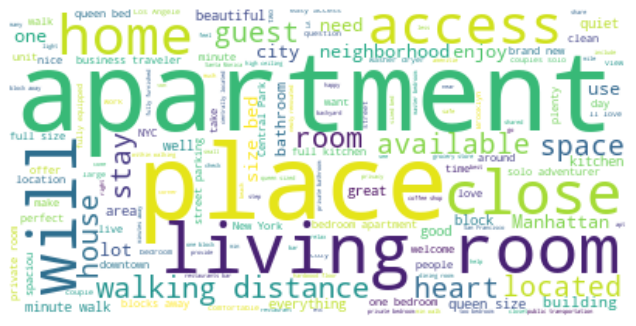

In [148]:
# Generate a word cloud image
wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(text)


figure(figsize=(10, 8), dpi=80)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

We could see that some of the common words used in the description from word cloud. For instance, Manhattan can be very expensive area so we can create the feature based upon this.

In [149]:
# Make a fucntion for finding a commonwords after removing stopword 
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer(stop_words = 'english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_words(train['description'], 40)
for word, freq in common_words:
    print(word, freq)
df2 = pd.DataFrame(common_words, columns = ['description' , 'count'])

room 41763
apartment 37855
bedroom 30042
kitchen 28439
bed 23349
private 21754
walk 19692
restaurants 19592
living 19192
bathroom 18588
located 17936
access 17745
place 17048
space 16782
away 16450
home 16381
neighborhood 16077
great 15867
park 15613
street 15348
close 15227
house 13252
new 13095
available 12906
area 12783
large 12592
minutes 12258
queen 11947
quiet 11883
floor 11730
city 11622
just 11238
building 11155
guests 10739
walking 10717
tv 10642
blocks 10529
parking 10334
beautiful 10270
stay 10045


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39]),
 [Text(0, 0, 'room'),
  Text(1, 0, 'apartment'),
  Text(2, 0, 'bedroom'),
  Text(3, 0, 'kitchen'),
  Text(4, 0, 'bed'),
  Text(5, 0, 'private'),
  Text(6, 0, 'walk'),
  Text(7, 0, 'restaurants'),
  Text(8, 0, 'living'),
  Text(9, 0, 'bathroom'),
  Text(10, 0, 'located'),
  Text(11, 0, 'access'),
  Text(12, 0, 'place'),
  Text(13, 0, 'space'),
  Text(14, 0, 'away'),
  Text(15, 0, 'home'),
  Text(16, 0, 'neighborhood'),
  Text(17, 0, 'great'),
  Text(18, 0, 'park'),
  Text(19, 0, 'street'),
  Text(20, 0, 'close'),
  Text(21, 0, 'house'),
  Text(22, 0, 'new'),
  Text(23, 0, 'available'),
  Text(24, 0, 'area'),
  Text(25, 0, 'large'),
  Text(26, 0, 'minutes'),
  Text(27, 0, 'queen'),
  Text(28, 0, 'quiet'),
  Text(29, 0, 'floor'),
  Text(30, 0, 'city'),
  Text(31, 0, 'just'),
  Text(32, 0, 'building'),
  Te

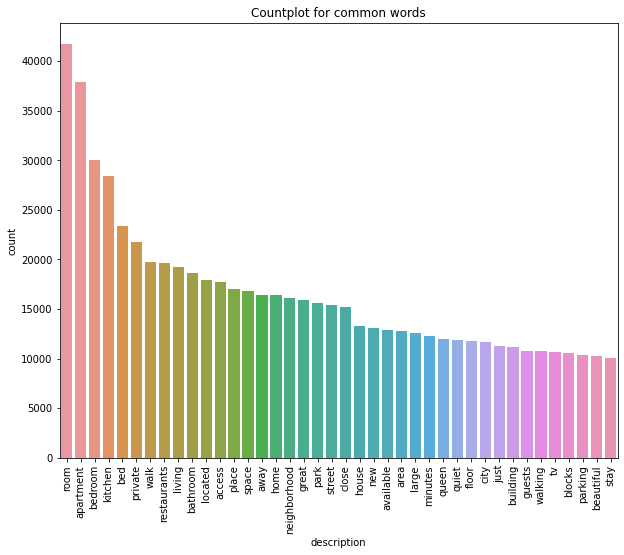

In [150]:
# Visualise the bar-plot
figure(figsize=(10, 8))
ax=sns.barplot(x='description',y='count',data=df2)
ax.set_title('Countplot for common words')
plt.xticks(rotation=90)

As can be stated from count plot, some variables might potential imply the listing price. In this case study, based on the count plot, I am trying to make some detection features for 'keywords' such as cheap and luxury.

In [151]:
# Detect whether or not description contain Manhattan.
train['detect_Manhattan'] = train['description'].str.extract(r'(Manhattan)')
train['detect_Manhattan'] = train['detect_Manhattan'].apply(lambda x:1 if x=='Manhattan' else 0)

# Detect whether or not description contain luxury
train['detect_luxury'] = train['description'].str.extract(r'(luxury)')
train['detect_luxury'] = train['detect_luxury'].apply(lambda x:1 if x=='luxury' else 0)

# Detect whether or not description contain parking
train['detect_parking'] = train['description'].str.extract(r'(parking)')
train['detect_parking'] = train['detect_parking'].apply(lambda x:1 if x=='parking' else 0)

# Detect whether or not description contain cheap
train['detect_cheap'] = train['description'].str.extract(r'(cheap)')
train['detect_cheap'] = train['detect_cheap'].apply(lambda x:1 if x=='cheap' else 0)

# Detect whether or not description contain large
train['detect_large'] = train['description'].str.extract(r'(large)')
train['detect_large'] = train['detect_large'].apply(lambda x:1 if x=='large' else 0)

# Detect whether or not description contain new
train['detect_new'] = train['description'].str.extract(r'(new)')
train['detect_new'] = train['detect_new'].apply(lambda x:1 if x=='new' else 0)

#### Name

I can also apply the similar method for the name. 

In [152]:
# Count the common word from name
common_words = get_top_n_words(train['name'], 40)
for word, freq in common_words:
    print(word, freq)
df3 = pd.DataFrame(common_words, columns = ['name' , 'count'])

room 7223
private 5819
bedroom 5335
apartment 3978
cozy 3455
apt 3089
studio 2891
spacious 2452
park 1957
home 1946
sunny 1930
near 1875
beautiful 1805
house 1560
modern 1550
location 1480
heart 1477
bed 1468
large 1428
brooklyn 1412
charming 1341
hollywood 1321
bath 1287
beach 1279
luxury 1259
loft 1233
east 1171
bright 1132
manhattan 1102
williamsburg 1050
great 1048
village 1044
west 1030
quiet 1010
br 938
new 904
clean 893
downtown 865
central 857
1br 856


(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39]),
 [Text(0, 0, 'room'),
  Text(1, 0, 'private'),
  Text(2, 0, 'bedroom'),
  Text(3, 0, 'apartment'),
  Text(4, 0, 'cozy'),
  Text(5, 0, 'apt'),
  Text(6, 0, 'studio'),
  Text(7, 0, 'spacious'),
  Text(8, 0, 'park'),
  Text(9, 0, 'home'),
  Text(10, 0, 'sunny'),
  Text(11, 0, 'near'),
  Text(12, 0, 'beautiful'),
  Text(13, 0, 'house'),
  Text(14, 0, 'modern'),
  Text(15, 0, 'location'),
  Text(16, 0, 'heart'),
  Text(17, 0, 'bed'),
  Text(18, 0, 'large'),
  Text(19, 0, 'brooklyn'),
  Text(20, 0, 'charming'),
  Text(21, 0, 'hollywood'),
  Text(22, 0, 'bath'),
  Text(23, 0, 'beach'),
  Text(24, 0, 'luxury'),
  Text(25, 0, 'loft'),
  Text(26, 0, 'east'),
  Text(27, 0, 'bright'),
  Text(28, 0, 'manhattan'),
  Text(29, 0, 'williamsburg'),
  Text(30, 0, 'great'),
  Text(31, 0, 'village'),
  Text(32, 0, 'west'),


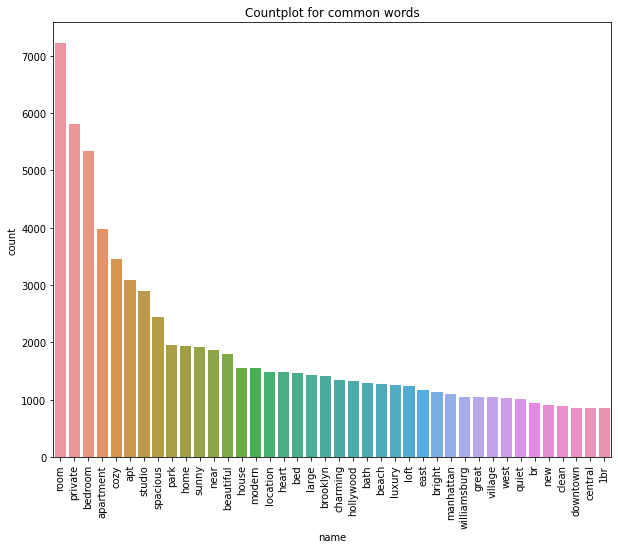

In [153]:
# Visualise the count plot
figure(figsize=(10, 8))
ax=sns.barplot(x='name',y='count',data=df3)
ax.set_title('Countplot for common words')
plt.xticks(rotation=90)

As can be seen, some of the important keywords has been used in the name of the accomodation. Hence, I am going to pick up the keyword as a new feature. 

In [154]:
# Detect whether or not namecontain brooklyn.
train['name_brooklyn'] = train['name'].str.extract(r'(brooklyn)')
train['name_brooklyn'] = train['name_brooklyn'].apply(lambda x:1 if x=='brooklyn' else 0)

# Detect whether or not namecontain hollywood.
train['name_hollywood'] = train['name'].str.extract(r'(hollywood)')
train['name_hollywood'] = train['name_hollywood'].apply(lambda x:1 if x=='hollywood' else 0)

# Detect whether or not namecontain willamsburg.
train['name_willamsburg'] = train['name'].str.extract(r'(willamsburg)')
train['name_willamsburg'] = train['name_willamsburg'].apply(lambda x:1 if x=='willamsburg' else 0)


# Detect whether or not namecontain cantral.
train['name_central'] = train['name'].str.extract(r'(central)')
train['name_central'] = train['name_central'].apply(lambda x:1 if x=='central' else 0)


# Detect whether or not namecontain cantral.
train['name_studio'] = train['name'].str.extract(r'(studio)')
train['name_studio'] = train['name_studio'].apply(lambda x:1 if x=='studio' else 0)


# Detect whether or not namecontain downtown.
train['name_downtown'] = train['name'].str.extract(r'(downtown)')
train['name_downtown'] = train['name_downtown'].apply(lambda x:1 if x=='downtown' else 0)

As machine learning model can not understand text data, name and description features will be removed for the model construction

In [155]:
# Drop the text data columns
train = train.drop(columns=['name','description'])

In [156]:
train.head()

,accommodates,bathrooms,bed_type,bedrooms,beds,city,latitude,longitude,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central,count_amenities,count_description,detect_Manhattan,detect_luxury,detect_parking,detect_cheap,detect_large,detect_new,name_brooklyn,name_hollywood,name_willamsburg,name_central,name_studio,name_downtown
0,6,2.0,0,1.0,4.0,0,33.788931,-118.154761,0,1,1,908,138.0,40.043679,7,76,0,0,0,0,0,0,0,0,0,0,0,0
1,2,1.0,1,1.0,1.0,0,34.068441,-118.353515,0,1,1,900,150.0,14.741809,17,169,0,0,0,0,0,0,0,0,0,0,0,0
2,3,1.0,0,1.0,1.0,0,34.088550,-118.268238,1,0,0,900,145.0,22.840190,23,151,0,0,0,0,0,1,0,0,0,0,0,0
3,2,1.0,0,1.0,1.0,0,34.097690,-118.350587,0,1,0,900,100.0,16.643890,12,46,0,0,0,0,0,0,0,0,0,0,0,0
4,2,1.0,0,1.0,1.0,0,34.154915,-118.030139,1,1,0,910,69.0,45.981711,10,48,0,0,0,0,0,0,0,0,0,0,0,0


## Construction of models

In order to predict the listing price, I am going to use random-forest. Also, as a hyperparameter tuning method, I am going to use random search which allows us to compute the hyper-parameter faster than grid-serach.

The optimised value for hyper-parameter is refered by https://towardsdatascience.com/hyperparameter-tuning-the-random-forest-in-python-using-scikit-learn-28d2aa77dd74

In [157]:
# Define the model
rf = RandomForestRegressor(random_state=42)

In [158]:
# Shuffle the dataset before cross-validation
train = shuffle(train)

In [159]:
# Create X_train and y_train
X_train = train.drop(columns='price')
y_train = train['price']

In [160]:
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 50, num = 5)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2]


# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf}

In [161]:
# Define Random serach based upon the range set by the random-grid
rf = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter=5, cv = 3, verbose=2, random_state=42, n_jobs = -1)
# Fit the random search model
rf.fit(X_train, y_train)

Fitting 3 folds for each of 5 candidates, totalling 15 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  15 out of  15 | elapsed: 21.7min finished


RandomizedSearchCV(cv=3, estimator=RandomForestRegressor(random_state=42),
                   n_iter=5, n_jobs=-1,
                   param_distributions={'max_depth': [10, 20, 30, 40, 50, None],
                                        'min_samples_leaf': [1, 2],
                                        'min_samples_split': [2, 5],
                                        'n_estimators': [200, 400, 600, 800,
                                                         1000, 1200, 1400, 1600,
                                                         1800, 2000]},
                   random_state=42, verbose=2)

In [162]:
rf.best_params_

{'n_estimators': 2000,
 'min_samples_split': 2,
 'min_samples_leaf': 2,
 'max_depth': 30}

In [163]:
# Show the most optimised parameter after random-search
best_random = rf.best_estimator_
print('Best Parameter is {}'.format(best_random))

Best Parameter is RandomForestRegressor(max_depth=30, min_samples_leaf=2, n_estimators=2000,
                      random_state=42)


In [164]:
# Show the feature importance
rf.best_estimator_.feature_importances_

array([3.15169620e-02, 2.52739323e-02, 1.18611563e-03, 9.30332715e-02,
       9.23198008e-03, 1.10119528e-02, 8.12765533e-02, 8.70567037e-02,
       1.30197104e-02, 3.51694290e-01, 5.43729682e-03, 1.11667301e-02,
       1.49657654e-01, 4.70183978e-02, 5.96776264e-02, 3.00217355e-03,
       3.53855064e-03, 4.32681935e-03, 2.54042853e-04, 5.65652557e-03,
       5.38923266e-03, 7.14347875e-06, 1.17506974e-06, 0.00000000e+00,
       3.66846294e-05, 4.64278225e-04, 6.41970267e-05])

In [165]:
print('Best Score is {}'.format(rf.best_score_))

Best Score is 0.6094138206986299


This part of code is modified based upon http://aiweeklynews.com/archives/50653819.html

1   room_type   0.35169429023430593
2   distance_from_central   0.14965765380944462
3   bedrooms   0.09303327152630794
4   longitude   0.08705670374600628
5   latitude   0.08127655331983732
6   count_description   0.059677626376780826
7   count_amenities   0.047018397762593374
8   accommodates   0.03151696203512654
9   bathrooms   0.02527393230020133
10   property_type   0.013019710429121872
11   zipcode   0.011166730099401357
12   city   0.011011952779844408
13   beds   0.009231980079620906
14   detect_large   0.005656525565693513
15   thumbnail_url   0.005437296824704464
16   detect_new   0.005389232656447019
17   detect_parking   0.004326819354718081
18   detect_luxury   0.00353855064156675
19   detect_Manhattan   0.0030021735450200975
20   bed_type   0.001186115630238272
21   name_studio   0.0004642782250698947
22   detect_cheap   0.0002540428533578186
23   name_downtown   6.419702674048885e-05
24   name_central   3.6684629363307736e-05
25   name_brooklyn   7.143478751690282e-06
26

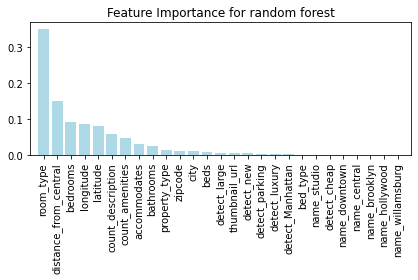

In [166]:
#Feature importance
feature = rf.best_estimator_.feature_importances_

#Output the feature importance in ascending order
f = pd.DataFrame({'number': range(0, len(feature)),
             'feature': feature[:]})
f2 = f.sort_values('feature',ascending=False)

#name of the feature importance
label = X_train.columns[0:]

#Show the feature importance
indices = np.argsort(feature)[::-1]

for i in range(len(feature)):
    print(str(i + 1) + "   " + str(label[indices[i]]) + "   " + str(feature[indices[i]]))

plt.title('Feature Importance for random forest')
plt.bar(range(len(feature)),feature[indices], color='lightblue', align='center')
plt.xticks(range(len(feature)), label[indices], rotation=90)
plt.xlim([-1, len(feature)])
plt.tight_layout()
plt.show()

## Validation of results

I am going to do the exact same procedure for test data in this section

#### Feature engineering for test data

In [167]:
test = test.rename(columns={'y':'price'})
# Remove unnecessary variables for my analytical question
test = test.drop(columns=['id','cancellation_policy','first_review','host_has_profile_pic','host_identity_verified','host_response_rate',
                     'host_since','instant_bookable','last_review','number_of_reviews','review_scores_rating','cleaning_fee'])

test['bathrooms'] = test["bathrooms"].fillna(1)
test['beds'] = test['beds'].fillna(test['accommodates'].apply(lambda x: 1 if x==1 or 2 else (2 if x==3 or 4 else 4)))
test['bedrooms'] = test['bedrooms'].fillna(test['accommodates'].apply(lambda x: 2 if x>5 else 1))
test = test.drop(columns='neighbourhood')
test.dropna(subset=['zipcode'],inplace=True)
test['thumbnail_url'] = test['thumbnail_url'].isnull() * 1

LA_test = test[test['city']=='LA']
SF_test = test[test['city']=='SF']
NYC_test = test[test['city']=='NYC'] 
Chicago_test = test[test['city']=='Chicago'] 
DC_test = test[test['city']=='DC'] 
Boston_test = test[test['city']=='Boston'] 


# Specify the iconic place in each area and calucurate the distance from each accommodation
Santa_Monica_Pier = (34.010090, -118.496948)
LA_test["distance_from_central"] = LA_test.apply(lambda x:geodesic((x["latitude"], x["longitude"]), Santa_Monica_Pier), axis=1)

White_House = (38.897957,-77.036560)
DC_test['distance_from_central'] = DC_test.apply(lambda x:geodesic((x["latitude"], x["longitude"]), White_House), axis=1)

Misson_Dolores_Park = (37.759773,-122.427063)
SF_test['distance_from_central'] = SF_test.apply(lambda x:geodesic((x["latitude"], x["longitude"]), Misson_Dolores_Park), axis=1)

SOHO = (40.758896,-73.985130)
NYC_test['distance_from_central'] = NYC_test.apply(lambda x:geodesic((x["latitude"], x["longitude"]), SOHO), axis=1)

Willis_Tower = (41.878876, -87.635918)
Chicago_test['distance_from_central'] = Chicago_test.apply(lambda x:geodesic((x["latitude"], x["longitude"]), Willis_Tower), axis=1)

State_House = (42.3587085, -71.0636623) 
Boston_test['distance_from_central'] = Boston_test.apply(lambda x:geodesic((x["latitude"], x["longitude"]), State_House), axis=1)

# Using inner merge and pandas concat to use 
LA_test_ = pd.merge(test, LA_test, how="inner")
DC_test_ = pd.merge(test, DC_test, how="inner")
SF_test_ = pd.merge(test, SF_test, how="inner")
NYC_test_ = pd.merge(test, NYC_test, how="inner")
Chicago_test_ = pd.merge(test, Chicago_test, how="inner")
Boston_test_ = pd.merge(test, Boston_test, how="inner")

# Combine all of the datas to add distance from central 
test = pd.concat([LA_test_,DC_test_,SF_test_,NYC_test_,Chicago_test_,Boston_test_],axis=0)

#Change distance to float since
test['distance_from_central'] = test['distance_from_central'].astype(str)
test['distance_from_central'] = test['distance_from_central'].str.split(' ', expand=True)[0]
test['distance_from_central'] = test['distance_from_central'].astype(float)

# Label encoding for city
test['city'] = test['city'].apply(lambda x:0 if x=='LA' 
                                    else(1 if x=='DC' else(2 if x=='SF' else(3 if x=='NYC' else(4 if x=='Chicago' else(5))))))

# Pick up the top 3 number for zipcode
test['zipcode'] = test["zipcode"].str[:3]

# Replace categorical variables to numerical variables
test['bed_type'] = test['bed_type'].apply(lambda x:0 if x=='Real Bed' 
                                      else(1 if x=='Pull-out Sofa' else(2 if x=='Airbed' else(3 if x=='Futon' else(4)))))


# Label encoding for property_type
test['property_type'] = test['property_type'].apply(lambda x:0 if x=='Apartment' 
                                                else(1 if x=='House' else(2 if x=='Condominium' 
                                                else(3 if x=='Townhouse' else(4 if x=='Loft' 
                                                else(5 if x=='Guesthouse' or x=='Bed & Breakfast' else(6)))))))


# Label encoding for room_type
test['room_type'] = test['room_type'].apply(lambda x:0 if x=='Entire home/apt' else(1 if x=='Private room' else(2)))

#Count the amenities
test['amenities'] = test['amenities'].apply(change_amenities)
test['count_amenities'] = test['amenities'].apply(lambda x: len(x))
test = test.drop(columns='amenities')

# Count the number of the description
test['count_description'] = test['description'].apply(lambda x: x.split())
test['count_description'] = test['count_description'].apply(lambda x: len(x))

# Detect whether or not description contain Manhattan.
test['detect_Manhattan'] = test['description'].str.extract(r'(Manhattan)')
test['detect_Manhattan'] = test['detect_Manhattan'].apply(lambda x:1 if x=='Manhattan' else 0)

# Detect whether or not description contain luxury
test['detect_luxury'] = test['description'].str.extract(r'(luxury)')
test['detect_luxury'] = test['detect_luxury'].apply(lambda x:1 if x=='luxury' else 0)

# Detect whether or not description contain parking
test['detect_parking'] = test['description'].str.extract(r'(parking)')
test['detect_parking'] = test['detect_parking'].apply(lambda x:1 if x=='parking' else 0)

# Detect whether or not description contain cheap
test['detect_cheap'] = test['description'].str.extract(r'(cheap)')
test['detect_cheap'] = test['detect_cheap'].apply(lambda x:1 if x=='cheap' else 0)

# Detect whether or not description contain large
test['detect_large'] = test['description'].str.extract(r'(large)')
test['detect_large'] = test['detect_large'].apply(lambda x:1 if x=='large' else 0)

# Detect whether or not description contain new
test['detect_new'] = test['description'].str.extract(r'(new)')
test['detect_new'] = test['detect_new'].apply(lambda x:1 if x=='new' else 0)

# Detect whether or not namecontain brooklyn.
test['name_brooklyn'] = test['name'].str.extract(r'(brooklyn)')
test['name_brooklyn'] = test['name_brooklyn'].apply(lambda x:1 if x=='brooklyn' else 0)

# Detect whether or not namecontain hollywood.
test['name_hollywood'] = test['name'].str.extract(r'(hollywood)')
test['name_hollywood'] = test['name_hollywood'].apply(lambda x:1 if x=='hollywood' else 0)

# Detect whether or not namecontain willamsburg.
test['name_willamsburg'] = test['name'].str.extract(r'(willamsburg)')
test['name_willamsburg'] = test['name_willamsburg'].apply(lambda x:1 if x=='willamsburg' else 0)


# Detect whether or not namecontain cantral.
test['name_central'] = test['name'].str.extract(r'(central)')
test['name_central'] = test['name_central'].apply(lambda x:1 if x=='central' else 0)


# Detect whether or not namecontain cantral.
test['name_studio'] = test['name'].str.extract(r'(studio)')
test['name_studio'] = test['name_studio'].apply(lambda x:1 if x=='studio' else 0)


# Detect whether or not namecontain downtown.
test['name_downtown'] = test['name'].str.extract(r'(downtown)')
test['name_downtown'] = test['name_downtown'].apply(lambda x:1 if x=='downtown' else 0)


# Drop the text data columns
test = test.drop(columns=['name','description'])

In [168]:
test.head()

,accommodates,bathrooms,bed_type,bedrooms,beds,city,latitude,longitude,property_type,room_type,thumbnail_url,zipcode,price,distance_from_central,count_amenities,count_description,detect_Manhattan,detect_luxury,detect_parking,detect_cheap,detect_large,detect_new,name_brooklyn,name_hollywood,name_willamsburg,name_central,name_studio,name_downtown
0,2,1.0,0,0.0,1.0,0,34.101967,-118.341149,0,0,0,900,120.0,17.628458,18,152,0,0,0,0,0,0,0,0,0,0,0,0
1,3,2.0,0,1.0,1.0,0,34.087267,-118.362788,1,1,0,900,74.0,15.057624,20,160,0,0,1,0,1,0,0,0,0,0,0,0
2,2,1.0,0,1.0,1.0,0,34.130686,-118.199647,1,1,0,900,80.0,30.530042,18,174,0,0,0,0,0,0,0,0,0,0,0,0
3,2,1.0,0,1.0,1.0,0,34.074938,-118.251764,1,1,0,900,46.0,23.755181,17,182,0,0,0,0,0,0,0,0,0,0,0,0
4,4,1.0,3,2.0,3.0,0,33.777209,-118.142966,1,0,0,908,120.0,41.705801,24,184,0,0,1,0,0,0,0,0,0,0,0,0


In [169]:
# Shuffle the dataset before cross-validation
test = shuffle(test)

# Create X_test and y_test
X_test = test.drop(columns='price')
y_test = test['price']

#### Prediction

In [170]:
# Prediction
y_pred = rf.predict(X_test)

#### Evaluation (RMSE)

As an evalutation metric, RMSE is applied for this regression task

In [171]:
# Define MSE
mse = mean_squared_error(y_test,y_pred)
# Change it to RMSE
rmse = math.sqrt(mse)
# Evaluate the scoring metrics
print('Our RMSE for the final model is {}'.format(rmse))

Our RMSE for the final model is 137.66046588327205


This part of code is modified by https://rin-effort.com/2019/12/26/machine-learning-5/

In [172]:
def True_Pred_map(pred_df):
    RMSE = np.sqrt(mean_squared_error(pred_df['true'], pred_df['pred']))
    plt.figure(figsize=(8,8))
    ax = plt.subplot(111)
    ax.scatter('true', 'pred', data=pred_df)
    ax.set_xlabel('True Value', fontsize=15)
    ax.set_ylabel('Pred Value', fontsize=15)
    ax.set_xlim(pred_df.min().min()-0.1 , pred_df.max().max()+0.1)
    ax.set_ylim(pred_df.min().min()-0.1 , pred_df.max().max()+0.1)
    x = np.linspace(pred_df.min().min()-0.1, pred_df.max().max()+0.1, 2)
    y = x
    ax.plot(x,y,'r-')
    plt.text(0.1, 0.9, 'RMSE = {}'.format(str(round(RMSE, 5))), transform=ax.transAxes, fontsize=15)

In [173]:
pred_df = pd.concat([y_test.reset_index(drop=True), pd.Series(y_pred)], axis=1)
pred_df.columns = ['true', 'pred']

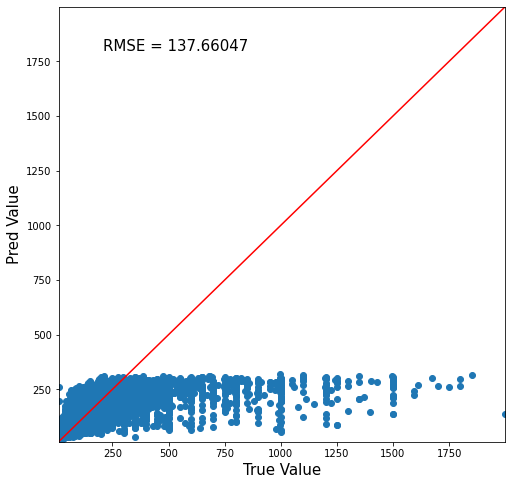

In [174]:
True_Pred_map(pred_df)